# Project

## 1. Motivation

The scope of this project is to shed light on the development of Covid in US and hopefully gain new insights on the subject. Several datasets are used for the analysis, including two datasets with covid numbers from healthdata.gov, population and density number and election results. This gives broad insights about the development of covid on both local hospital level and for each state. 

The first data set is from healthdata.gov and provides the number of confirmed and suspected covid cases on a hospital level. This data set contains several different covid and influenza numbers from hospital patients, as well as the geocoded location of each hospital. In total the data contains of 128 columns and ?? rows. This data makes it possible for us to create a heatmap with exact location of the reported covid cases. This data is however only reported on a weekly basis, meaning that each row is the aggregated facility report for a given collection week. To get an overview of the covid development and indicate political influence on such, the data has been combined with election results of all states. These data has been used to color code a heatmap into Republican, Democrats and swing states. 


The second data set from healthdata.gov provides hospital registrations on a state level. This data differs from the first by also having death numbers and registrations of critical staffing has been registered. The data contains 135 columns and ?? rows. The critical staffing rate is the number of hospitals reporting a critical staffing shortage the given day, and for this analysis we will calculate the percentage of hosptials with critical staffing. 

This data is combined with population and density numbers World Population Review, to investigate the relationship between state density and the spread of covid. 

Both data sets contains several columns that has not been used for the analysis. The selection has been based on using attributes that are easy to comprehend and relate to each other. For further analysis, more data from the used data sets could be used. 

The goal is to present all this data in a comprehensive and easily intrepretable way and to give the reader usefull insights about what happend in 2020-2023. 

## 2. Basic stats

### Data preperation ### 

First part of the project is to clean and prepare the data. Both covid data set contains many columns and using all of them for our analysis would be overkill. Therefore we have selected a few relevant columns that are meaningfull for the scope of the project. Furthermore nan values and negative values are set to 0 to aviod outliers in the data. 

The links to the data sources are listed below:


**Hospital data:** [COVID-19 Reported Patient Impact and Hospital Capacity by Facility](https://healthdata.gov/Hospital/COVID-19-Reported-Patient-Impact-and-Hospital-Capa/anag-cw7u/about_data)

**Population data:** [United States by Density 2024](https://worldpopulationreview.com/state-rankings/state-densities)

**State data:** [COVID-19 Reported Patient Impact and Hospital Capacity by State Timeseries (RAW)](https://healthdata.gov/Hospital/COVID-19-Reported-Patient-Impact-and-Hospital-Capa/g62h-syeh/about_data)

**State bounderies:** [Folium Example Data](https://raw.githubusercontent.com/python-visualization/folium-example-data/main/us_states.json)

**Election data:** [List of Red And Blue States 2023 in the US](https://www.jagranjosh.com/general-knowledge/red-and-blue-states-in-us-1701677972-1)

#### Package import

In [61]:
#Package import
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import folium
import folium.plugins as plugins
from folium.plugins import HeatMapWithTime
from bokeh.io import output_file
from bokeh.palettes import Category20
from bokeh.models import Legend, LegendItem, FixedTicker
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import ColumnDataSource
from bokeh.models import FactorRange
import requests
from sklearn.cluster import KMeans



#### Hospital data

In [62]:
# reading the hospital-based data
df_hospital = pd.read_csv('Data/COVID19.csv')

# Splitting the geocoded hospital address into latitude and longitude. 
df_hospital['latlong'] = df_hospital['geocoded_hospital_address'].str.split('(', expand=True)[1]
df_hospital['long'] = df_hospital['latlong'].str.split(' ', expand=True)[0]
df_hospital['lat'] = df_hospital['latlong'].str.split(' ', expand=True)[1]
df_hospital['lat'] = df_hospital['lat'].str.split(')', expand=True)[0]
df_hospital['long'] = df_hospital['long'].astype(float)
df_hospital['lat'] = df_hospital['lat'].astype(float)

# convert to datetime format
df_hospital['date'] = pd.to_datetime(df_hospital['collection_week'])
df_hospital['year'] = df_hospital['date'].dt.year
df_hospital['weeknumber'] = df_hospital['date'].dt.isocalendar().week

columns = ['total_adult_patients_hospitalized_confirmed_covid_7_day_sum', 'date', 'weeknumber', 'year', 'lat', 'long']
df_hospital = df_hospital[columns]

# replace nan and negative values with 0 in column total_adult_patients_hospitalized_confirmed_covid_7_day_avg
df_hospital['total_adult_patients_hospitalized_confirmed_covid_7_day_sum'] = df_hospital['total_adult_patients_hospitalized_confirmed_covid_7_day_sum'].replace(np.nan, 0)
df_hospital['total_adult_patients_hospitalized_confirmed_covid_7_day_sum'] = df_hospital['total_adult_patients_hospitalized_confirmed_covid_7_day_sum'].apply(lambda x: 0 if x <= 0 else x)

df_hospital['number'] = df_hospital['total_adult_patients_hospitalized_confirmed_covid_7_day_sum']

df_hospital = df_hospital[['date', 'lat', 'long', 'number']]

df_hospital = df_hospital[df_hospital['number'] != 0]

df_hospital = df_hospital.sort_values(by='date')

# normalize df_hospital['number'] to [0,1]
df_hospital['number'] = (df_hospital['number'] - df_hospital['number'].min()) / (df_hospital['number'].max() - df_hospital['number'].min())

data_hm = []
dates = df_hospital['date'].unique()
for i in dates:
    temp = []
    for index, instance in df_hospital[df_hospital['date'] == i].iterrows():
        temp.append([instance['lat'], instance['long'], instance['number']])
    data_hm.append(temp)

time_index = dates.strftime("%Y-%m-%d").tolist()


#### Population data

In [63]:
#reading the population data 
pop=pd.read_csv('Data/united-states-by-density-2024.csv',sep=';')   
#rename columns
pop.columns=['State','Density','Population','TotalArea']

#replace pop['State'] with state short names
pop['State']=pop['State'].replace(['Alabama','Alaska','Arizona','Arkansas','California','Colorado','Connecticut','Delaware','Florida','Georgia','Hawaii','Idaho','Illinois','Indiana','Iowa','Kansas','Kentucky','Louisiana','Maine','Maryland','Massachusetts','Michigan','Minnesota','Mississippi','Missouri','Montana','Nebraska','Nevada','New Hampshire','New Jersey','New Mexico','New York','North Carolina','North Dakota','Ohio','Oklahoma','Oregon','Pennsylvania','Rhode Island','South Carolina','South Dakota','Tennessee','Texas','Utah','Vermont','Virginia','Washington','West Virginia','Wisconsin','Wyoming'],
['AL','AK','AZ','AR','CA','CO','CT','DE','FL','GA','HI','ID','IL','IN','IA','KS','KY','LA','ME','MD','MA','MI','MN','MS','MO','MT','NE','NV','NH','NJ','NM','NY','NC','ND','OH','OK','OR','PA','RI','SC','SD','TN','TX','UT','VT','VA','WA','WV','WI','WY'])

#only keep the columns we need
pop=pop[['State','Population','Density']]

#replace "." with ""
pop['Density']=pop['Density'].apply(lambda x: x.replace('.',''))
pop['Density']=pop['Density'].astype(float)

#### State data

In [64]:
#Inporting the state data
df_state = pd.read_csv('Data/COVID_data.csv')

#Filtering the columns
column1='critical_staffing_shortage_today_yes'
column2='total_adult_patients_hospitalized_confirmed_covid'
column3='deaths_covid'
column4='critical_staffing_shortage_today_no'
column5='critical_staffing_shortage_today_not_reported'
columns=['state',column1,column2,column3,column4,column5,'date']
df_state = df_state[columns]

#fill missing values with 0 and negative values with 0
df_state.fillna(0,inplace=True)

#replace negative values with 0
df_state[column1]=df_state[column1].apply(lambda x: 0 if x<0 else x)
df_state[column4]=df_state[column4].apply(lambda x: 0 if x<0 else x)
df_state[column5]=df_state[column5].apply(lambda x: 0 if x<0 else x)
df_state['Hospitalized']=df_state[column2].apply(lambda x: 0 if x<0 else x)
df_state['Deaths']=df_state[column3].apply(lambda x: 0 if x<0 else x)

#Calculate the percentage of hospitals with critical staffing
df_state['Staffing']=df_state[column1]/(df_state[column4]+df_state[column5]+df_state[column1])

#Change the date format to %Y-%m
df_state['date']=pd.to_datetime(df_state['date'])
df_state['date']=df_state['date'].dt.strftime('%Y-%m')

#filter data to after 2020-06
df_state=df_state[df_state['date']>='2020-06']

#Merge the state data with the population data
df_state=pd.merge(df_state,pop,how='inner',left_on='state',right_on='State')

#Calculate the percentage of hospitalized and death cases in the population
df_state['Hospitalized_pop']=df_state['Hospitalized']/df_state['Population']
df_state['Death_pop']=df_state['Deaths']/df_state['Population']


data=df_state[['date','Hospitalized_pop','Death_pop','Staffing','Density']]



#### State bounderies json file and state colors 

In [65]:
geo_json_data = requests.get(
    "https://raw.githubusercontent.com/python-visualization/folium-example-data/main/us_states.json"
).json()
df_statecolor = pd.read_csv("Data/StateColor.csv",sep=';',header=None)
df_statecolor.columns = ['State', 'Color','','']
df_statecolor=df_statecolor[['State','Color']]
df_statecolor['Color']=df_statecolor['Color'].replace(['Democrat','Swing State','Republicans'],['blue','purple','red'])
color_code = {key: val for key, val in zip(df_statecolor['State'], df_statecolor['Color'])}


Now the data is clustered into 3 clusters based on the state density using kMeans 

In [66]:
densities=data['Density'].unique()

# Reshape the data into a format compatible with KMeans
d = densities.reshape(-1, 1)

# Define the number of clusters
num_clusters = 3

# Initialize the KMeans model with the number of clusters
kmeans = KMeans(n_clusters=num_clusters)

# Fit the model to your data
kmeans.fit(d)

# Get the cluster labels for each data point
cluster_labels = kmeans.labels_

dentity_groups=pd.DataFrame({'Density':densities,'Cluster':cluster_labels})
#map the clusters to data
data=pd.merge(data,dentity_groups,how='inner',left_on='Density',right_on='Density')
df_state=pd.merge(df_state,dentity_groups,how='inner',left_on='Density',right_on='Density')


#Group the data by date and cluster
data=data.groupby(['Cluster','date']).mean().reset_index()

data=data.sort_values(by='Density',ascending=True)
cluster_order=data['Cluster'].unique()

clusternames=['Low Density','Medium Density','High Density']
#sort clusternames after cluster order:
clusternames=[x for _,x in sorted(zip(cluster_order,clusternames))]

#add clusternames to data
data['Density_group']=data['Cluster'].apply(lambda x: clusternames[x])
df_state['Density_group']=df_state['Cluster'].apply(lambda x: clusternames[x])

### Simple plots

Firstly, we have made a time series plot of the columns hospitalised covid patients, covid deaths and critical staffing, all normalised. We see the pattern in the lines are roughly similar, aside from the first few months, where it seems like critical staffing isn't used yet. 

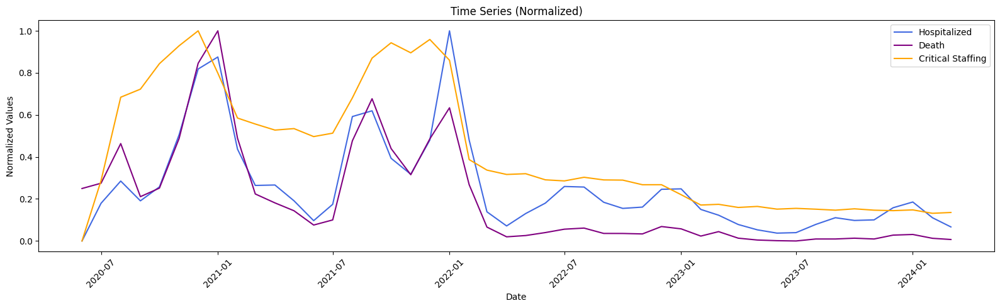

In [67]:
# Sort the dataframe by date
data_sorted = df_state.sort_values(by='date')

# Filter data before plotting
data_filtered = data_sorted[data_sorted['date'] >= '2020-02-01']

# Convert date to datetime
data_filtered['date'] = pd.to_datetime(data_filtered['date'])

# Group data by date and calculate the mean
data_grouped = data_filtered.groupby('date').sum().reset_index()

# Initialize lists to store normalized values
normalized_hospitalized = []
normalized_death = []
normalized_staffing = []

# Manual normalization
for column in ['Hospitalized', 'Deaths', 'Staffing']:
    column_data = data_grouped[column]
    min_val = min(column_data)
    max_val = max(column_data)
    normalized_column = [(x - min_val) / (max_val - min_val) for x in column_data]
    
    if column == 'Hospitalized':
        normalized_hospitalized = normalized_column
    elif column == 'Deaths':
        normalized_death = normalized_column
    elif column == 'Staffing':
        normalized_staffing = normalized_column

# Set the figure size
plt.figure(figsize=(16, 5))

# Plot normalized Hospitalized_pop
plt.plot(data_grouped['date'], normalized_hospitalized, label='Hospitalized', color='royalblue')

# Plot normalized Death_pop
plt.plot(data_grouped['date'], normalized_death, label='Death', color = 'purple')

# Plot normalized Staffing
plt.plot(data_grouped['date'], normalized_staffing, label='Critical Staffing', color = 'orange')

# Set labels and title
plt.xlabel('Date')
plt.ylabel('Normalized Values')
plt.title('Time Series (Normalized)')
plt.xticks(rotation=45)

plt.legend()

# Show plot
plt.tight_layout()
plt.show()

To illustrate the paterns for the individual states, we also made seperate time series plots for each of them.

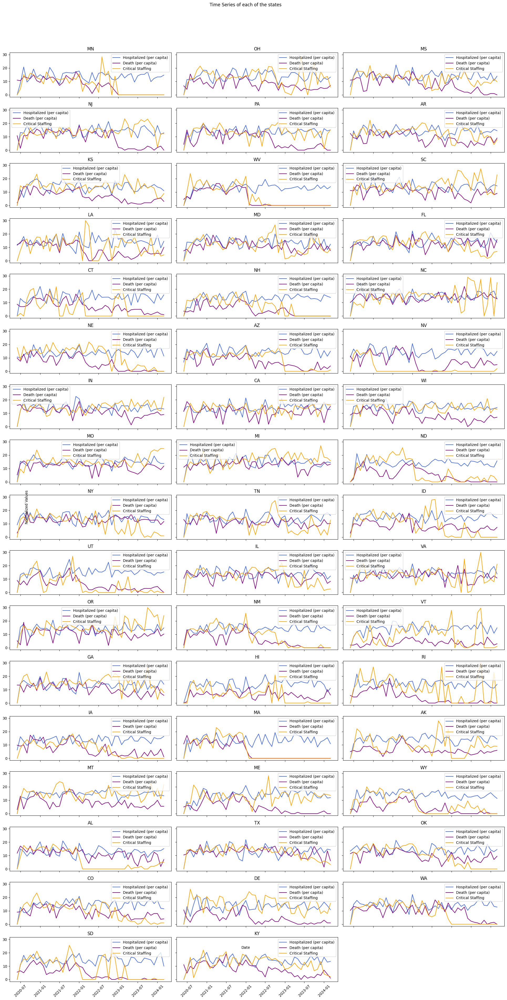

In [68]:
# Sort the dataframe by date
data_sorted = df_state.sort_values(by='date')

# Filter data before plotting
data_filtered = data_sorted[data_sorted['date'] >= '2020-02-01']

# Convert date to datetime
data_filtered['date'] = pd.to_datetime(data_filtered['date'])

# Get unique states
states = data_filtered['state'].unique()

# Set up the plot grid
fig, axs = plt.subplots(17, 3, figsize=(20, 40), sharex=True, sharey=True)

# Flatten the subplot array for easy iteration
axs = axs.flatten()

# Iterate over each state
for i, state in enumerate(states):
    # Filter data for the state
    state_data = data_filtered[data_filtered['state'] == state]
    
    # Check if there's data for the state
    if not state_data.empty:

        normalized_data = state_data.groupby('date')[['Hospitalized_pop', 'Death_pop', 'Staffing']].apply(lambda x: (x - x.min()) / (x.max() - x.min()))

        # Summing the normalized values by date
        summed_data_by_date = normalized_data.groupby('date').sum().reset_index()

        # Plot normalized values for the state
        axs[i].plot(summed_data_by_date['date'], summed_data_by_date['Hospitalized_pop'], label='Hospitalized (per capita)', color='royalblue')
        axs[i].plot(summed_data_by_date['date'], summed_data_by_date['Death_pop'], label='Death (per capita)', color='purple')
        axs[i].plot(summed_data_by_date['date'], summed_data_by_date['Staffing'], label='Critical Staffing', color='orange')

        
        # Set title
        axs[i].set_title(state)
        
        # Rotate x-axis labels for better readability
        axs[i].tick_params(axis='x', rotation=45)
        
        # Add legend
        axs[i].legend()

# Set common labels
fig.text(0.5, 0.08, 'Date', ha='center')
fig.text(0.08, 0.5, 'Normalized Values', va='center', rotation='vertical')
fig.suptitle('Time Series of each of the states')

# Adjust layout
fig.tight_layout(rect=[0.03, 0.03, 1, 0.95])

# Remove empty plots
for j in range(len(states), len(axs)):
    fig.delaxes(axs[j])

# Show plot
plt.show()


Then we have made a bar plot, to illustrate the hospitalised covid patients pr state pr capita. The top three are California, Florida and Delaware, and the bottom three are Oregon, Utah and Vermont. 

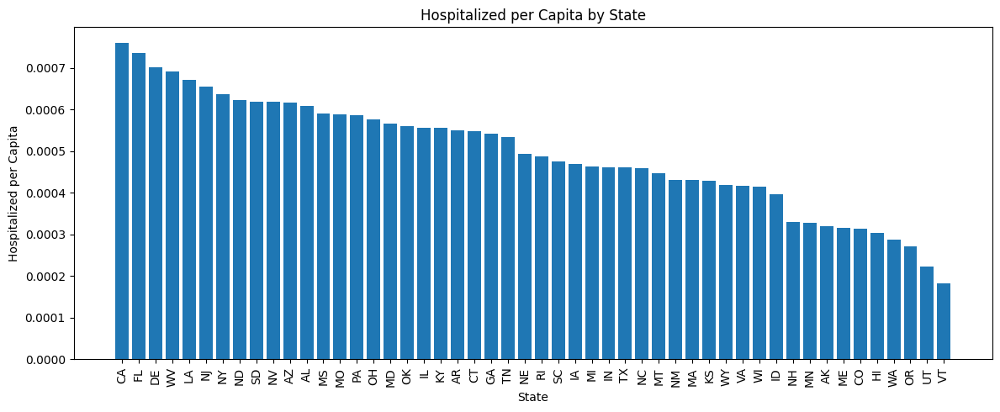

In [69]:
# Sort the dataframe by 'Hospitalized_pop' 
df_state_sorted = df_state.sort_values(by='Hospitalized_pop', ascending=False)
# Set the figure size
plt.figure(figsize=(12, 5))

# Plot the bar graph
plt.bar(df_state_sorted['state'], df_state_sorted['Hospitalized_pop'])

# Set labels and title
plt.xlabel('State')
plt.ylabel('Hospitalized per Capita')
plt.title('Hospitalized per Capita by State')

# Rotate state labels for better readability
plt.xticks(rotation=90)

# Show plot
plt.tight_layout()
plt.show()



We also made a bar plot illustrating the number of covid deaths pr state pr capita. Here, the top three states are Iowa, North Dakota and Oregon and bottom three are Minnesota, Colorado and Utah.

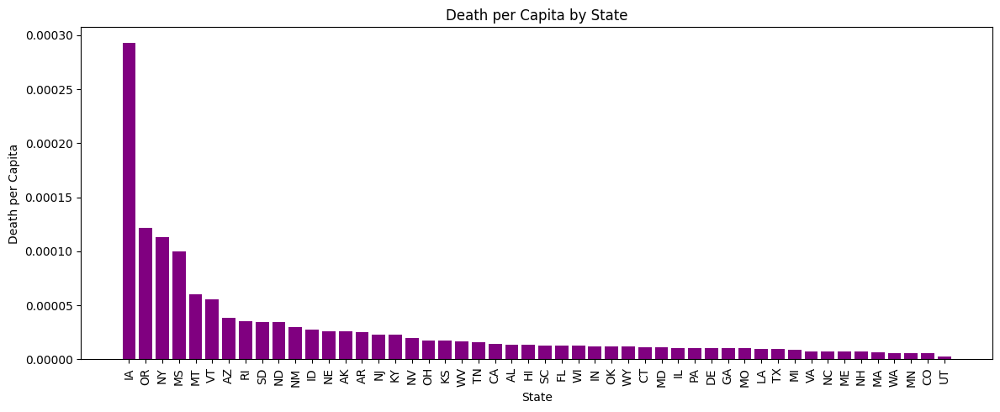

In [70]:
# Sort the dataframe by 'Death_pop'
df_state_sorted = df_state.sort_values(by='Death_pop', ascending=False)

# Set the figure size
plt.figure(figsize=(12, 5))

# Plot the bar graph
plt.bar(df_state_sorted['state'], df_state_sorted['Death_pop'], color='purple')

# Set labels and title
plt.xlabel('State')
plt.ylabel('Death per Capita')
plt.title('Death per Capita by State')

# Rotate state labels for better readability
plt.xticks(rotation=90)

# Show plot
plt.tight_layout()
plt.show()

We also made a barplot illustrating critical staffing pr state. Here the top three are California, Texas and Kentucky, and the bottom three are Conneticut, Hawaii and Delaware.

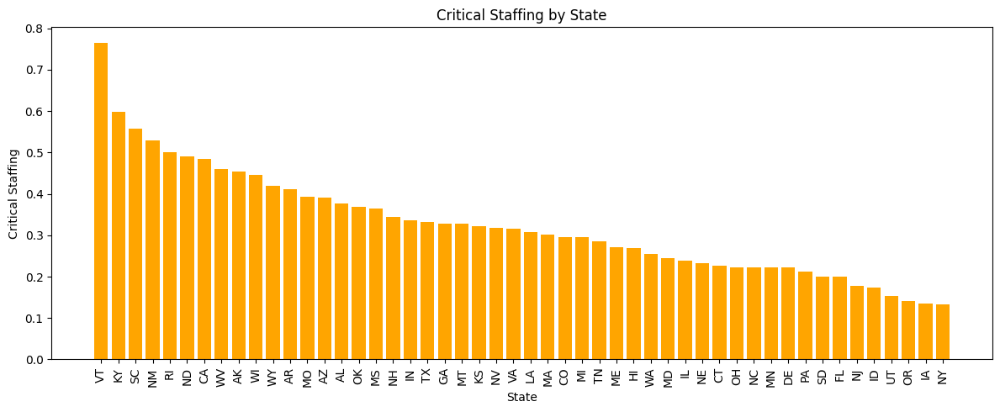

In [71]:
# Sort the dataframe by 'Staffing'
df_state_sorted = df_state.sort_values(by='Staffing', ascending=False)

# Set the figure size
plt.figure(figsize=(12, 5))

# Plot the bar graph 
plt.bar(df_state_sorted['state'], df_state_sorted['Staffing'], color='orange')

# Set labels and title
plt.xlabel('State')
plt.ylabel('Critical Staffing')
plt.title('Critical Staffing by State')

# Rotate state labels for better readability
plt.xticks(rotation=90)

# Show plot
plt.tight_layout()
plt.show()

Finally, we made a bar plot of the density of the states, just to illustrate the difference between them. Here the top three most dense states are New Jersey, Rhode Island and Massachusetts and the bottom three most dense states are Wyoming, Tenessee and Alaska. 

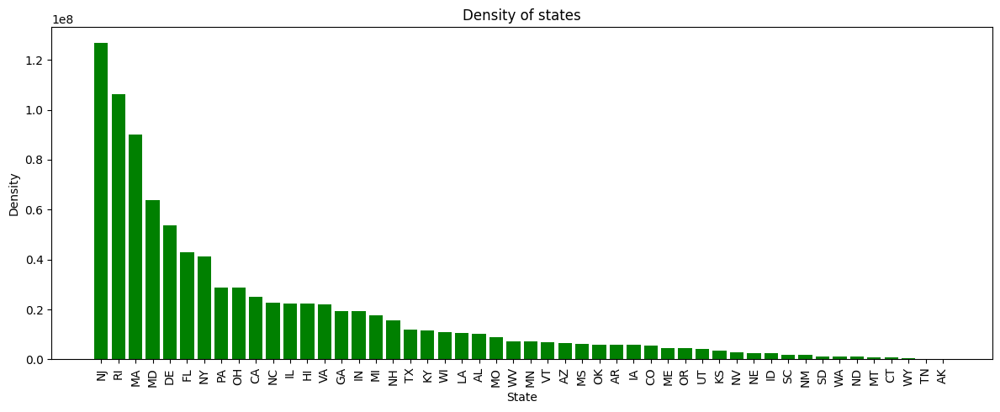

In [72]:
# Sort the dataframe by 'Density'
df_state_sorted = df_state.sort_values(by='Density', ascending=False)

# Set the figure size
plt.figure(figsize=(12, 5))

# Plot the bar graph 
plt.bar(df_state_sorted['state'], df_state_sorted['Density'], color='green')

# Set labels and title
plt.xlabel('State')
plt.ylabel('Density')
plt.title('Density of states')

# Rotate state labels for better readability
plt.xticks(rotation=90)

# Show plot
plt.tight_layout()
plt.show()

## 3. Data Analysis

Noticeably, there are way more hospitalized covid patients than covid related deaths, so when wanting to compare the two with each other and with critical staffing, it is easier to analyse a plot of the data normalized. 

The normalised time series showed how the critical staffing follows the first big wave of hospitalized covid patients and increased again during the second wave of hospitalized patients in sebtemper 2021 and stay to the next big peak in january 2022. 

Aditionally, we found that the general statistics pr state-level could vary a lot, which is showed in the both the individual time series and the barplots. The barplots also revealed that the states that had the most hospitalised patients weren’t neccesarrily the states that had the most deaths. When visualising time series’ of the states individually, we really got to see how different 

However, visualising the either hospitalised patients, covid deaths or critical staffing on a state level while also wanting to the compare the states is messy, as we saw with the individual time series plots in the previous section. A solution to this problem is to use a heatmap, where the numbers for each state can be shown at a given time, which is further explained in section 5. Visualizations. 


## 4. Genre

We opted for the magazine style to tell our story, along with many differen Visual Narrative and Narrative Structure tools.
From the three categories of the *Visual Narrative* column, we have used Consistent Visual Platform, Motion and Feature Distinction. 


From the three categories of the *Narrative Structure* column we have used Linear ordering, Hover Highlighting / Details, Filtering / Selection / Search, Very Limited Interactivity, Stimulating Default Views, Captions / Headlines, Accompanying Article, Introductory Text and Summary / Synthesis. In short, we produced an article to accompany our data visualisations and tell a linear story. In this article, we provided visualisations, where some are interactive in regards to filtering and hover details. 


## 5. Visualizations
Explain the visualizations you've chosen.
Why are they right for the story you want to tell?

For our article we have choosen to do a heatmap and two Bokeh plots. The aim of the heatmap is to visualise the covid development over time and combine covid cases on hospitals with the political color of each state. The Bokeh plots compare states of different dentities to investigate wether the density of a state has an effect on the covid numbers. For this, the data has been grouped in 6 groups based on the density of the state. 

#### Heatmap

The heatmap is created using Foliums HeatMapWithTime. The color of the states are added using a GeoJsonTooltip. To do so, we have used [this guide on heatmaps over time](https://python-visualization.github.io/folium/latest/user_guide/plugins/heatmap_with_time.html) as well as [this guide on adding election data to the map](https://medium.com/@shiv7/mapping-us-election-data-clusters-in-python-using-folium-and-geojson-35fd1d804008).

In [73]:
tooltip = folium.GeoJsonTooltip(
    fields=["name"],
    aliases=["State: "],
    localize=False,
    sticky=True,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 1px grey;
        border-radius: 1px;
        box-shadow: 1px;
    """,
    max_width=800,
    overlay=True,
)

votes=folium.GeoJson(
    geo_json_data,
    style_function=lambda x: {
        'fillColor':color_code.get(x['properties']['name']),
        'color': 'white',
        'weight': 0.5,
        'fillOpacity': 0.25,
    },
    tooltip=tooltip
)

gradient = {.00000001: 'mediumseagreen', .33: 'gold', .99: 'tomato'}
map = folium.plugins.HeatMapWithTime(data_hm, index=time_index, auto_play=True, max_opacity=0.9,blur=0.9,min_speed=9,max_speed=11,speed_step=0.5,gradient=gradient)


m = folium.Map([38.27312, -98.5821872], zoom_start=4, tiles="Cartodb Positron",
    attr="Google maps")


map.add_to(m)
votes.add_to(m)

legend_html = '''
     <div style="position: fixed; 
                 bottom: 80px; left: 50px; width: 100px; height: 80px; 
                 background-color: white; border:2px solid grey; z-index:5999; font-size:12px;
                 ">&nbsp;  <br>
                  &nbsp; Democrats &nbsp; <i class="fa fa-square fa-1x" style="color:blue"></i><br>
                  &nbsp; Swing State &nbsp; <i class="fa fa-square fa-1x" style="color:purple"></i><br>
                  &nbsp; Republicans &nbsp; <i class="fa fa-square fa-1x" style="color:red"></i>
      </div>
     '''
m.get_root().html.add_child(folium.Element(legend_html))

m


In [74]:
#save as html
m.save('covid_heatmap.html')

As seen from the heatmap above we have a slow start in 2019, but an increasing number of cases during 2021 and 2022. We see most cases on the East Coast, which could be correlated with larger population numbers in this area. Therefore we will now continue to look further into the development compared to population and dentity numbers.

#### Bokeh plots

To investigate the effect of the density of the state, we create two Bokeh plots, showing the development in average critical staffing and the number of covid cases in hospitals per capita.

Further more we want to investigate the influence of the political color of a state, plotting 3 bokeh plots of death numbers, covid positive patients and critical staffing rate. 

For all plots, we use the mean of deaths and covid cases per capita, meaning that smaller states will have the same weight as larger states. 

In [75]:
plot_object='Staffing'

#pivot data
rate=data.pivot(index='date',columns='Density_group',values=plot_object).reset_index()
rate['date']=pd.to_datetime(rate['date'])
rate['date']=rate['date'].dt.strftime('%b %y')
#set date as index
rate.set_index('date',inplace=True)

#drop column and row names
rate.columns.name=None
rate.index.name=None

#replace nan with 0
rate.fillna(0,inplace=True)

rate['date']=rate.index
dates=rate['date'] # -----------------------------

#rename columns
densitynames=data['Density_group'].unique()
groups=densitynames

title=plot_object

src=ColumnDataSource(rate)
n = len(groups)
# Initialize Bokeh figure with proper x-axis range - o
p = figure(x_range=FactorRange(factors=dates), width=800, height=400, title=title, x_axis_label='Date', y_axis_label='Average critical staffing rate')

# Create bars for each focuscrime
line = {}
bar={}
items=[]
for indx, i in enumerate(groups):
    line[i] = p.line(x='date', y=i, source=src, muted_alpha=1, muted=True, line_width=2, color=Category20[n][indx])
    items.append((i, [line[i]]))

legend = Legend(items=items, location=(0, 0))


# Set the click policy of the legend to "hide"
legend.click_policy = "hide"


#set x-axis label orientation and font size
p.xaxis.major_label_orientation = 3.14/2
p.xaxis.major_label_text_font_size = "10pt"


#p.xaxis.ticker = FixedTicker(ticks=list(range(0, len(dates), 10)))


# Display the plot
p.add_layout(legend, 'right')

# Display plot in Jupyter notebook and note in browser

output_notebook()
show(p)
output_file(title+'.html')


Loading BokehJS ...

We see that the development in the critical staffing rate is similar for the three groups, but the high dentity group has a larger peak in the summer and fall of 2021. 

#### Bokeh density vs hospitalized

In [76]:
plot_object='Hospitalized_pop'

#pivot data
rate=data.pivot(index='date',columns='Density_group',values=plot_object).reset_index()
rate['date']=pd.to_datetime(rate['date'])
rate['date']=rate['date'].dt.strftime('%b %y')
#set date as index
rate.set_index('date',inplace=True)

#drop column and row names
rate.columns.name=None
rate.index.name=None

#replace nan with 0
rate.fillna(0,inplace=True)

rate['date']=rate.index
dates=rate['date'] # -----------------------------

#rename columns
densitynames=data['Density_group'].unique()
groups=densitynames

title=plot_object

src=ColumnDataSource(rate)
n = len(groups)
# Initialize Bokeh figure with proper x-axis range - o
p = figure(x_range=FactorRange(factors=dates), width=800, height=400, title=title, x_axis_label='Date', y_axis_label='Average Hospitalized per Capita')

# Create bars for each focuscrime
line = {}
bar={}
items=[]
for indx, i in enumerate(groups):
    line[i] = p.line(x='date', y=i, source=src, muted_alpha=1, muted=True, line_width=2, color=Category20[n][indx])
    items.append((i, [line[i]]))

legend = Legend(items=items, location=(0, 0))


# Set the click policy of the legend to "hide"
legend.click_policy = "hide"


#set x-axis label orientation and font size
p.xaxis.major_label_orientation = 3.14/2
p.xaxis.major_label_text_font_size = "10pt"


#p.xaxis.ticker = FixedTicker(ticks=list(range(0, len(dates), 10)))


# Display the plot
p.add_layout(legend, 'right')

# Display plot in Jupyter notebook and note in browser

output_notebook()
show(p)
output_file(title+'.html')


Loading BokehJS ...

For the average number of hospitalised with covid, we see similar behavior for all three groups, again with a small exeption in the fall of 2021. 

In [77]:
#convert state names to two letters
df_statecolor['State']=df_statecolor['State'].replace(['Alabama','Alaska','Arizona','Arkansas','California','Colorado','Connecticut','Delaware','Florida','Georgia','Hawaii','Idaho','Illinois','Indiana','Iowa','Kansas','Kentucky','Louisiana','Maine','Maryland','Massachusetts','Michigan','Minnesota','Mississippi','Missouri','Montana','Nebraska','Nevada','New Hampshire','New Jersey','New Mexico','New York','North Carolina','North Dakota','Ohio','Oklahoma','Oregon','Pennsylvania','Rhode Island','South Carolina','South Dakota','Tennessee','Texas','Utah','Vermont','Virginia','Washington','West Virginia','Wisconsin','Wyoming'],
['AL','AK','AZ','AR','CA','CO','CT','DE','FL','GA','HI','ID','IL','IN','IA','KS','KY','LA','ME','MD','MA','MI','MN','MS','MO','MT','NE','NV','NH','NJ','NM','NY','NC','ND','OH','OK','OR','PA','RI','SC','SD','TN','TX','UT','VT','VA','WA','WV','WI','WY'])

In [78]:
#merge df_state and df_statecolor
df_state=pd.merge(df_state,df_statecolor,how='inner',left_on='state',right_on='State')

In [79]:
#deaths_covid
#group by date and color
df_color=df_state[['date','Color','total_adult_patients_hospitalized_confirmed_covid']]
df_color=df_color.groupby(['date','Color']).mean().reset_index()

#replace colors with party names
df_color['Color']=df_color['Color'].replace(['blue','purple','red'],['Democrat','Swing State','Republicans'])

#pivot data
data=df_color.pivot(index='date', columns='Color',values='total_adult_patients_hospitalized_confirmed_covid').reset_index()
data['date']=pd.to_datetime(data['date'])
data['date']=data['date'].dt.strftime('%b %y')
#set date as index
data.set_index('date',inplace=True)

#drop column and row names
data.columns.name=None
data.index.name=None

#replace nan with 0
data.fillna(0,inplace=True)

data['date']=data.index
dates=data['date'] # -----------------------------
#rename columns
colors=['Democrat','Swing State','Republicans']
groups=colors

title='Adult patients hospitalized by political color'

src=ColumnDataSource(data)
n=len(groups)

p=figure(x_range=FactorRange(factors=dates), width=800, height=400, title=title, x_axis_label='Date', y_axis_label='Average number of hospitalized patients with covid')

line={}
items=[]

colors=['blue','purple','red']

for indx, i in enumerate(groups):
    line[i] = p.line(x='date', y=i, source=src, muted_alpha=1, muted=True, line_width=2, color=colors[indx])
    items.append((i, [line[i]]))

legend = Legend(items=items, location=(0, 0))

legend.click_policy = "hide"

p.xaxis.major_label_orientation = 3.14/2
p.xaxis.major_label_text_font_size = "10pt"

# Display the plot
p.add_layout(legend, 'right')

# Display plot in Jupyter notebook and note in browser

output_notebook()
show(p)
output_file(title+'.html')




Loading BokehJS ...

Looking at the political groups, we see similar behaviour, but the swing states do in general have more covid patients pr capita than the other states. The republican states has the lowest numbers the most of the time.

In [80]:
#group by date and color
df_color=df_state[['date','Color','deaths_covid']]
df_color=df_color.groupby(['date','Color']).mean().reset_index()

#replace colors with party names
df_color['Color']=df_color['Color'].replace(['blue','purple','red'],['Democrat','Swing State','Republicans'])

#pivot data
data=df_color.pivot(index='date', columns='Color',values='deaths_covid').reset_index()
data['date']=pd.to_datetime(data['date'])
data['date']=data['date'].dt.strftime('%b %y')
#set date as index
data.set_index('date',inplace=True)

#drop column and row names
data.columns.name=None
data.index.name=None

#replace nan with 0
data.fillna(0,inplace=True)

data['date']=data.index
dates=data['date'] # -----------------------------
#rename columns
colors=['Democrat','Swing State','Republicans']
groups=colors

title='Covid deaths by political color'

src=ColumnDataSource(data)
n=len(groups)

p=figure(x_range=FactorRange(factors=dates), width=800, height=400, title=title, x_axis_label='Date', y_axis_label='Average number of covid deaths')

line={}
items=[]

colors=['blue','purple','red']

for indx, i in enumerate(groups):
    line[i] = p.line(x='date', y=i, source=src, muted_alpha=1, muted=True, line_width=2, color=colors[indx])
    items.append((i, [line[i]]))

legend = Legend(items=items, location=(0, 0))

legend.click_policy = "hide"

p.xaxis.major_label_orientation = 3.14/2
p.xaxis.major_label_text_font_size = "10pt"

# Display the plot
p.add_layout(legend, 'right')

# Display plot in Jupyter notebook and note in browser

output_notebook()
show(p)
output_file(title+'.html')




Loading BokehJS ...

The development in number of deaths looks similar to the number of hospitalized, with the exeption that the number of deaths is staying on a low level in 2023 and 2024 eventhough the number of hospitalized with covid has a small increase. 

In [81]:
#group by date and color
df_color=df_state[['date','Color','Staffing']]
df_color=df_color.groupby(['date','Color']).mean().reset_index()

#replace colors with party names
df_color['Color']=df_color['Color'].replace(['blue','purple','red'],['Democrat','Swing State','Republicans'])

#pivot data
data=df_color.pivot(index='date', columns='Color',values='Staffing').reset_index()
data['date']=pd.to_datetime(data['date'])
data['date']=data['date'].dt.strftime('%b %y')
#set date as index
data.set_index('date',inplace=True)

#drop column and row names
data.columns.name=None
data.index.name=None

#replace nan with 0
data.fillna(0,inplace=True)

data['date']=data.index
dates=data['date'] # -----------------------------
#rename columns
colors=['Democrat','Swing State','Republicans']
groups=colors

title='Critical staffing rate by political color'

src=ColumnDataSource(data)
n=len(groups)

p=figure(x_range=FactorRange(factors=dates), width=800, height=400, title=title, x_axis_label='Date', y_axis_label='Average critical staffing rate')

line={}
items=[]

colors=['blue','purple','red']

for indx, i in enumerate(groups):
    line[i] = p.line(x='date', y=i, source=src, muted_alpha=1, muted=True, line_width=2, color=colors[indx])
    items.append((i, [line[i]]))

legend = Legend(items=items, location=(0, 0))

legend.click_policy = "hide"

p.xaxis.major_label_orientation = 3.14/2
p.xaxis.major_label_text_font_size = "10pt"

# Display the plot
p.add_layout(legend, 'right')

# Display plot in Jupyter notebook and note in browser

output_notebook()
show(p)
output_file(title+'.html')




Loading BokehJS ...

Despite from having the lowest number of hospitalized with covid and death numbers similar to the democratic states, the repuplican states has larger issues with critical staffing rates than the other states, especially in the beginning of the pandemic in 2020 and 2021. 

## 6. Discussion
When analyzing a big pandemic like Covid, there is naturally many ways to go about the project. For this project, we have focused on covid cases on hospitals. We choose to go this way since we were able to find good and reliable data on this, where “normal” testing might have differed more from state to state based on the political situation in different states. 


The data used had both pros and cons. Naturally it would have been preferable to have all data combined in one data set and not having to shift between the two as it was done. When finding the hospital-based data set, we also hoped to have more data on other things than the number of covid cases, such as staffing levels and such. The data did however contain more columns on bed occupancy and such but we where unable to convert these numbers to valuable insights. If we where to investigate the data further, these numbers would be a good place to start. 


Another issue we faced with the hospital data was the time index available. This data set contains aggregated data for a week range, and having the numbers for each day would have given us a more natural moving and accurate heatmap. 
Despite from the things we missed in the data, we found that the data used was both reliable and easy to use. The data consisted of mainly raw data and the only preprocessing done was aggregation and average values. This gave us the opportunity to do the preprocessing ourselves and easily get the data needed. 


We decided to calculate the covid cases and deaths per capita, to be able to compare states of different sizes. This was the most obvious way to handle the fact that the size of the states are different, but we could have looked more into the raw numbers as well to see if anything was hidden. The use of density made it possible to reflect on the influence of how close people live, which gave new insights to our analysis. Further more we grouped data by both density groups and political colors using mean of all states in that given group. This meant that a small red state and a large red state had the same weight in our plots. This is a choiche we did in order to make sure that all states counted, but we could also have calculated the per capita numbers for the group as a whole instead, which might had given other conclusions.


The main goal of this project was to gain new insights on the Covid pandemic in the US, as well as communicating the data with useful plots and visualizations. To introduce the data, we started out with creating a heatmap of all data over time. A lot of effort went into making the layout of the plot nice and the data easy to understand. We decided to add the political colors to gain more insights. Looking at our other analysis, we do not consider the heatmap as the most valuable plot and the results did not give us the new information we hoped for. It is however not useless and gives an intuition of the overall development. 


To investigate the difference between states, we considered the population and the density of the states to be of large importance. We therefore decided to investigate the relationship between the density of a state and the number of covid cases, deaths and the average critical staffing rate detected. This proved to be a good idea, given that we were able to see a difference in critical staffing, but not significantly for the death numbers and covid cases. Having expected to see a difference in all three numbers, these plots surprised us and can hopefully surprise our readers to. 
During the course we have been encouraged to use and reflect on our use of LLMs. This has also been relevant for this project, where we have used LLMs when we have found it meaningful. For the notebook we have used Githubs Copilot, which is a large help to remember syntax and how to do simple operations. Copilot has saved us time googling and searching stack overflow, which has given us more time to work on the actual project. Using Copilot and Chat GPT is however not without problems and should always be used with care.
For the creating of the website it has been difficult to find similar projects online, and having very little experience with Github previous to this course, using LLM has been a great tool to get help creating the website. **MERE OM DETTE**. 



## 7. Contributions

Both members has contributed to all parts of the project with the following main responsibilities (er det stavet korrekt):

**Notebook**

|  | s191817 | s183195 |
| --- | --- | --- |
| 1. Motivation |  x | |
| 2. Basic stats |  |  x |
| 3. Data Analysis |  x | |
| 4. Genre |  |  x |
| 5. Visualizations |  x | |
| 6. Discussion |  x |  x|

**Article**
|  | s191817 | s183195 |
| --- | --- | --- |
| Creating the website |   | x|
| Introduction | x |   |
| Column 1|   | |
| Column 2|  |   |
| Column 3 |   | |
| Conclusions |  x |  x|


